# Libraries

In [ ]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow
# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

import os

In [ ]:
# !curl -L "https://app.roboflow.com/ds/0Ywnnj8qWM?key=yuvI7oFWGb" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

# Ckeck format of Dataset

In [ ]:
DatasetCatalog.clear()
from detectron2.data.datasets import register_coco_instances
register_coco_instances("_my_dataset_train", {}, "data/for_coco_segmentation/train/_annotations.coco.json", "data/for_coco_segmentation/train")
register_coco_instances("_my_dataset_val", {}, "data/for_coco_segmentation/valid/_annotations.coco.json", "data/for_coco_segmentation/valid/")
register_coco_instances("_my_dataset_test", {}, "data/for_coco_segmentation/test/_annotations.coco.json", "data/for_coco_segmentation/test")

In [ ]:
# Verify that the COCO dataset has been loaded correctly
datasets = ["_my_dataset_train", "_my_dataset_val"]
for d in datasets:
    dataset_dicts = DatasetCatalog.get(d)
    for idx, d in enumerate(random.sample(dataset_dicts, 3)):
        print(f"Image {idx}: {d['file_name']}")

[05/24 06:36:37 d2.data.datasets.coco]: Loading data/for_coco_segmentation/train/_annotations.coco.json takes 3.08 seconds.
WARNING [05/24 06:36:37 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/24 06:36:37 d2.data.datasets.coco]: Loaded 1869 images in COCO format from data/for_coco_segmentation/train/_annotations.coco.json
Image 0: data/for_coco_segmentation/train/map_38-75407851884676_-90-09826869552843_38-75439227220899_-90-0972011763405_0_0_png_jpg.rf.7b8eeff64078466f18ee90ddea8acf83.jpg
Image 1: data/for_coco_segmentation/train/Screenshot-from-2023-05-18-22-24-07_png_jpg.rf.266e87ad297754bc7286cf95c270d3d7.jpg
Image 2: data/for_coco_segmentation/train/test_4_png_jpg.rf.fef3ece75c1c37de4bc6b0a935f80793.jpg
WARNING [05/24 06:36:37 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/24 06:36:37 d2.data.datasets.coco]: Loaded 178 images in COCO forma

WARNING [05/24 06:36:38 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/24 06:36:38 d2.data.datasets.coco]: Loaded 1869 images in COCO format from data/for_coco_segmentation/train/_annotations.coco.json


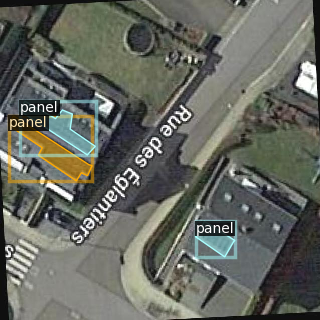

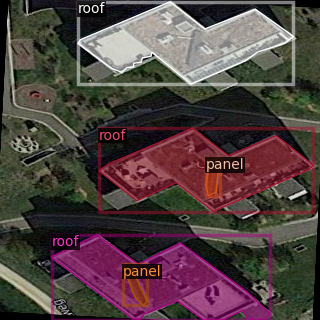

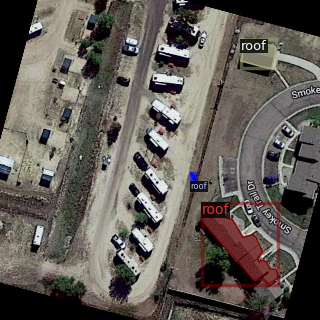

In [ ]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("_my_dataset_train")
dataset_dicts = DatasetCatalog.get("_my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Train Custom Detectron2 Detector

In [ ]:
#We are importing our own Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.
# COCOEvaluator'
# SemSegEvaluator
# CityscapesEvaluator
# DatasetEvaluator
# Evaluator
# inference_on_dataset
# RotatedCOCOEvaluator
# get_evaluator
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:
#from .detectron2.tools.train_net import Trainer
#from detectron2.engine import DefaultTrainer
# select from modelzoo here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-object-detection-baselines

from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

# cfg = get_cfg()
# cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
# cfg.DATASETS.TRAIN = ("my_dataset_train",)
# cfg.DATASETS.TEST = ("my_dataset_val",)
# cfg.DATALOADER.NUM_WORKERS = 4
# cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
# cfg.SOLVER.IMS_PER_BATCH = 4
# cfg.SOLVER.BASE_LR = 0.001
# cfg.SOLVER.WARMUP_ITERS = 500
# cfg.SOLVER.MAX_ITER = 300 #adjust up if val mAP is still rising, adjust down if overfit
# cfg.SOLVER.STEPS = (1000, 1500)
# cfg.SOLVER.GAMMA = 0.05
# cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
# cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2 #your number of classes + 1
# cfg.TEST.EVAL_PERIOD = 500

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("_my_dataset_val",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 1000    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # The "RoIHead batch size". 128 is faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # only has one class (ballon). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.



In [ ]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[05/24 06:46:52 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[05/24 06:46:53 d2.engine.train_loop]: Starting training from iteration 0
[05/24 06:47:00 d2.utils.events]:  eta: 0:05:30  iter: 19  total_loss: 2.946  loss_cls: 1.376  loss_box_reg: 0.5803  loss_mask: 0.6919  loss_rpn_cls: 0.3384  loss_rpn_loc: 0.04433    time: 0.3447  last_time: 0.2997  data_time: 0.0190  last_data_time: 0.0079   lr: 4.9953e-06  max_mem: 1939M
[05/24 06:47:08 d2.utils.events]:  eta: 0:05:41  iter: 39  total_loss: 2.762  loss_cls: 1.294  loss_box_reg: 0.5351  loss_mask: 0.6892  loss_rpn_cls: 0.2548  loss_rpn_loc: 0.04548    time: 0.3530  last_time: 0.4141  data_time: 0.0107  last_data_time: 0.0258   lr: 9.9902e-06  max_mem: 1939M
[05/24 06:47:15 d2.utils.events]:  eta: 0:05:32  iter: 59  total_loss: 2.879  loss_cls: 1.167  loss_box_reg: 0.5407  loss_mask: 0.676  loss_rpn_cls: 0.2538  loss_rpn_loc: 0.04522    time: 0.3506  last_time: 0.3796  data_time: 0.0074  last_data_time: 0.0055   lr: 1.4985e-05  max_mem: 1939M
[05/24 06:47:21 d2.utils.events]:  eta: 0:05:20  iter:

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir=output/ --port=8008


The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 8008 (pid 7177), started 0:13:22 ago. (Use '!kill 7177' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
%reload_ext tensorboard

# Inference & evaluation using the trained model

In [ ]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("_my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "_my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

[05/24 06:52:47 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
WARNING [05/24 06:52:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [05/24 06:52:47 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/24 06:52:47 d2.data.datasets.coco]: Loaded 92 images in COCO format from data/for_coco_segmentation/test/_annotations.coco.json
[05/24 06:52:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[05/24 06:52:47 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[05/24 06:52:47 d2.data.common]: Serializing 92 elements to byte tensors and concatenating them all ...
[05/24 06:52:47 d2.data.common]: Seriali

OrderedDict([('bbox',
              {'AP': 23.63658978987557,
               'AP50': 41.197590287122935,
               'AP75': 24.614669932849946,
               'APs': 5.982337973445628,
               'APm': 24.612061181910672,
               'APl': 30.77372247820356,
               'AP-roof-panel': nan,
               'AP-panel': 14.175481475702883,
               'AP-roof': 33.09769810404825}),
             ('segm',
              {'AP': 23.491423981186603,
               'AP50': 38.88081500559508,
               'AP75': 24.38847008182891,
               'APs': 5.013899281055834,
               'APm': 23.827289839507163,
               'APl': 30.569787554930333,
               'AP-roof-panel': nan,
               'AP-panel': 13.551303897471904,
               'AP-roof': 33.431544064901296})])

In [ ]:
# %ls output

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("_my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("_my_dataset_test")

[05/24 06:45:17 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


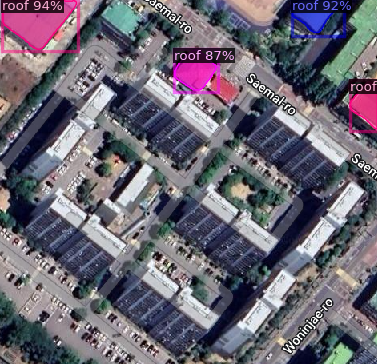

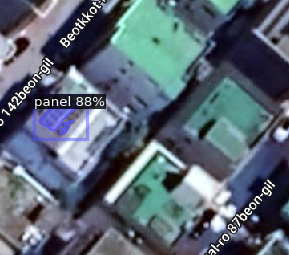

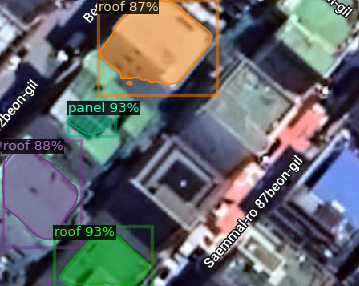

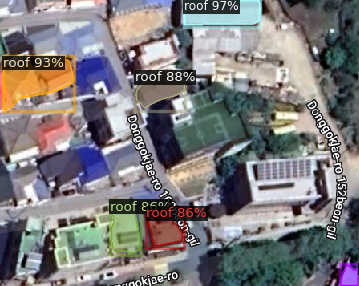

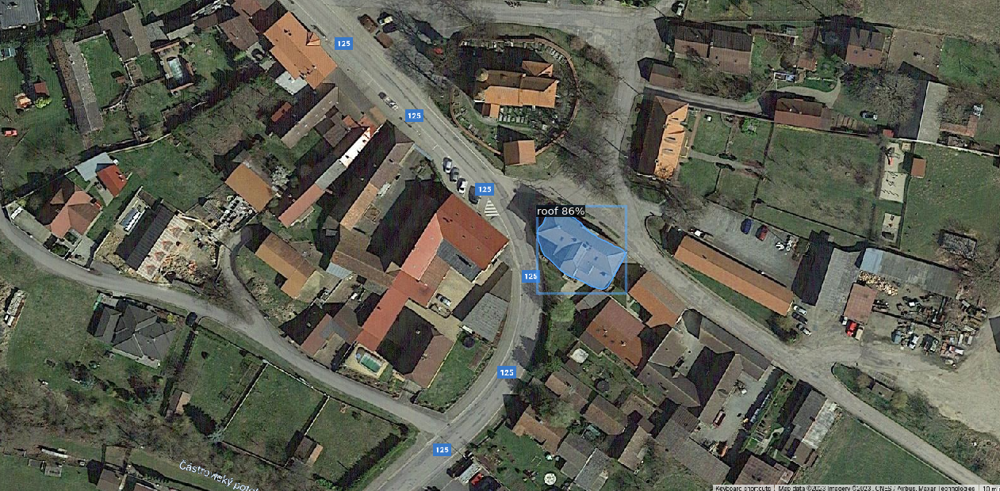

...

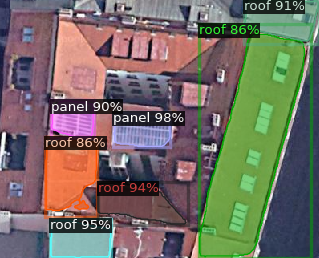

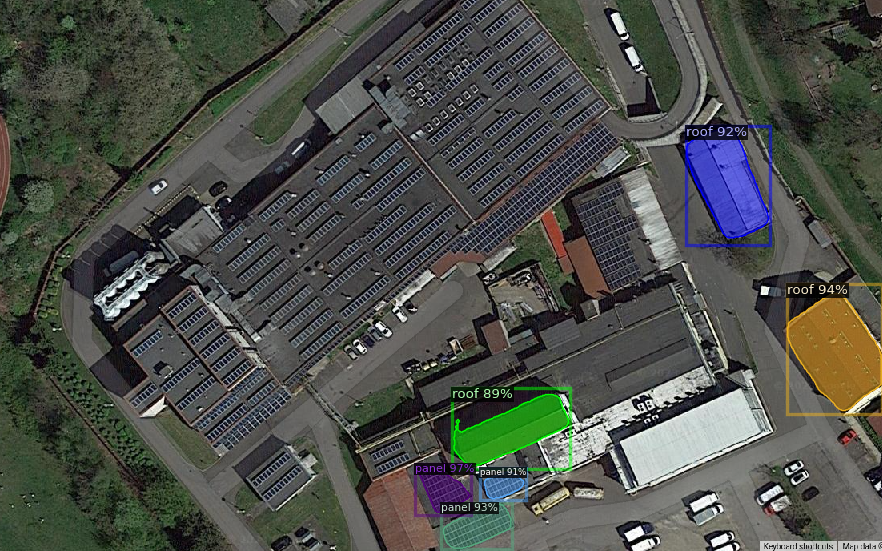

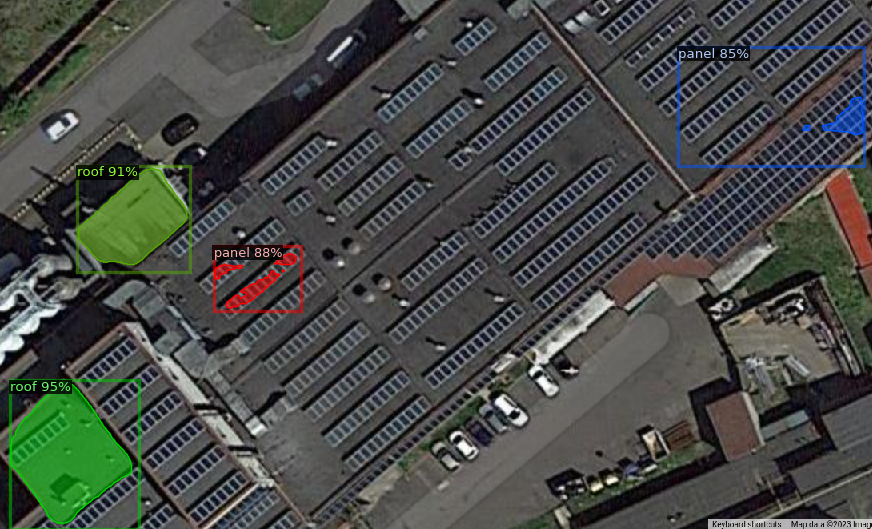

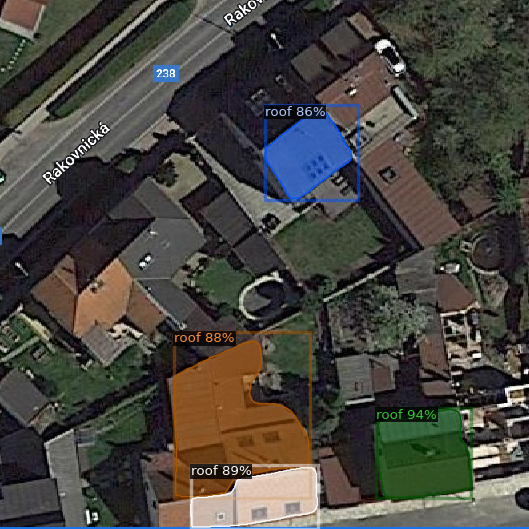

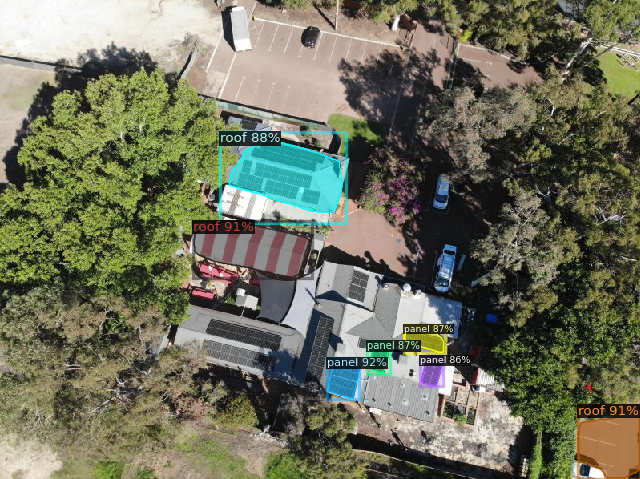

In [ ]:
from detectron2.utils.visualizer import ColorMode
import glob
k= 0
for imageName in glob.glob('data/folder_for_test_pic/new/*'):
  k = k +1 
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
  cv2.imwrite('/content/drive/MyDrive/Proactiveware/figure_results/mask_R_CNN/{}.png'.format(k), out.get_image()[:, :, ::-1])

